Generating data insights visualizations...


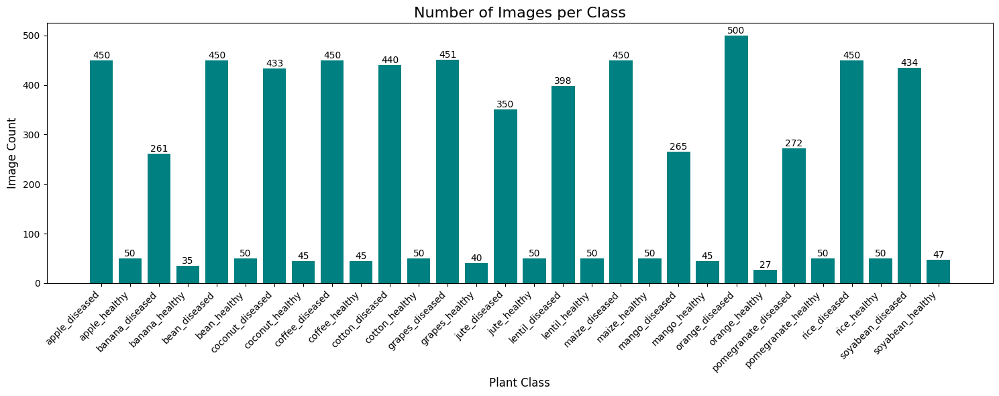

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter

def plot_class_distribution(data_dir):
    """Histogram of image counts per class"""
    class_counts = {}
    for class_name in os.listdir(data_dir):
        class_path = os.path.join(data_dir, class_name)
        if os.path.isdir(class_path):
            count = len(os.listdir(class_path))
            class_counts[class_name] = count
    
    plt.figure(figsize=(15, 6))
    bars = plt.bar(class_counts.keys(), class_counts.values(), color='teal')
    plt.title("Number of Images per Class", fontsize=16)
    plt.xlabel("Plant Class", fontsize=12)
    plt.ylabel("Image Count", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    
    # Add count labels on bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{int(height)}',
                ha='center', va='bottom')
    
    plt.tight_layout()
    plt.savefig('class_distribution.png', dpi=300)
    plt.show()




# Main execution
if __name__ == "__main__":
    data_dir = r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'  # Update this path
    
    print("Generating data insights visualizations...")
    plot_class_distribution(data_dir)

Visualizing sample images for all crops...
Found crops: apple, banana, bean, coconut, coffee, cotton, grapes, jute, lentil, maize, mango, orange, pomegranate, rice, soyabean

Processing apple...


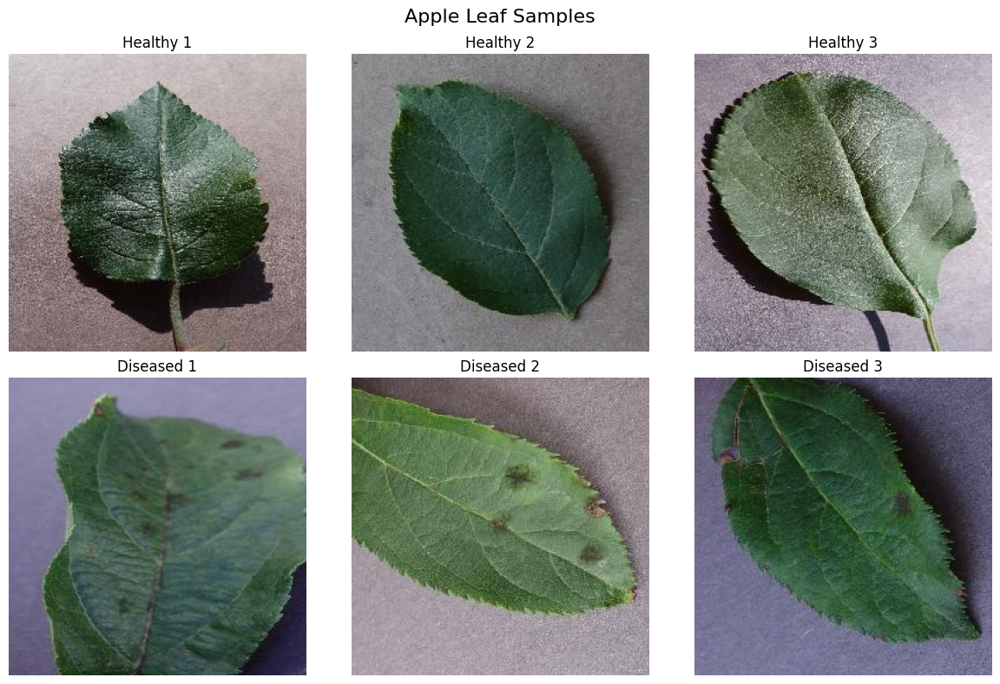


Processing banana...


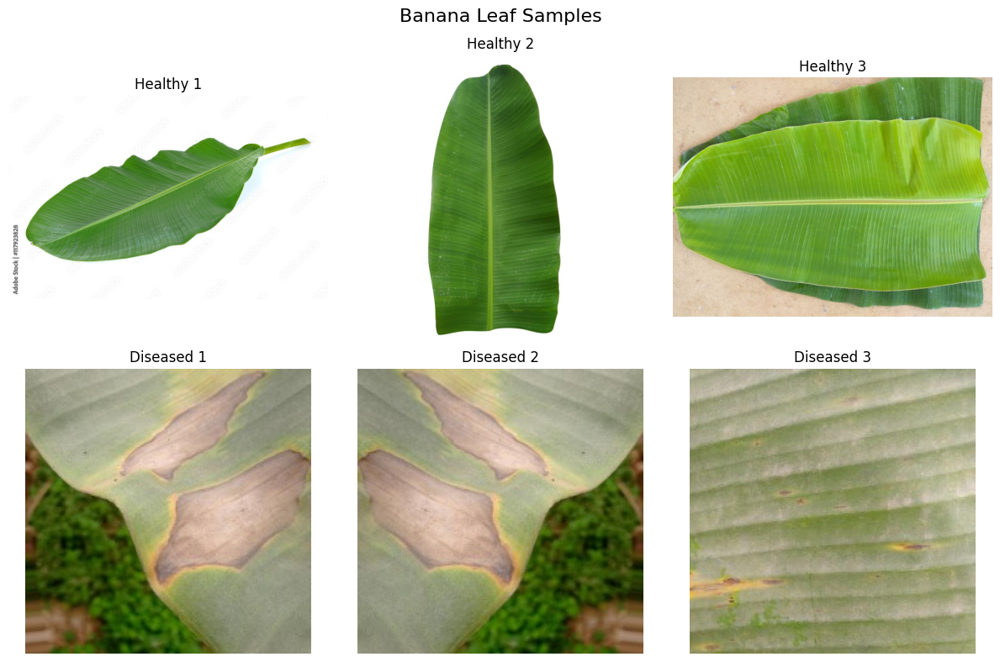


Processing bean...


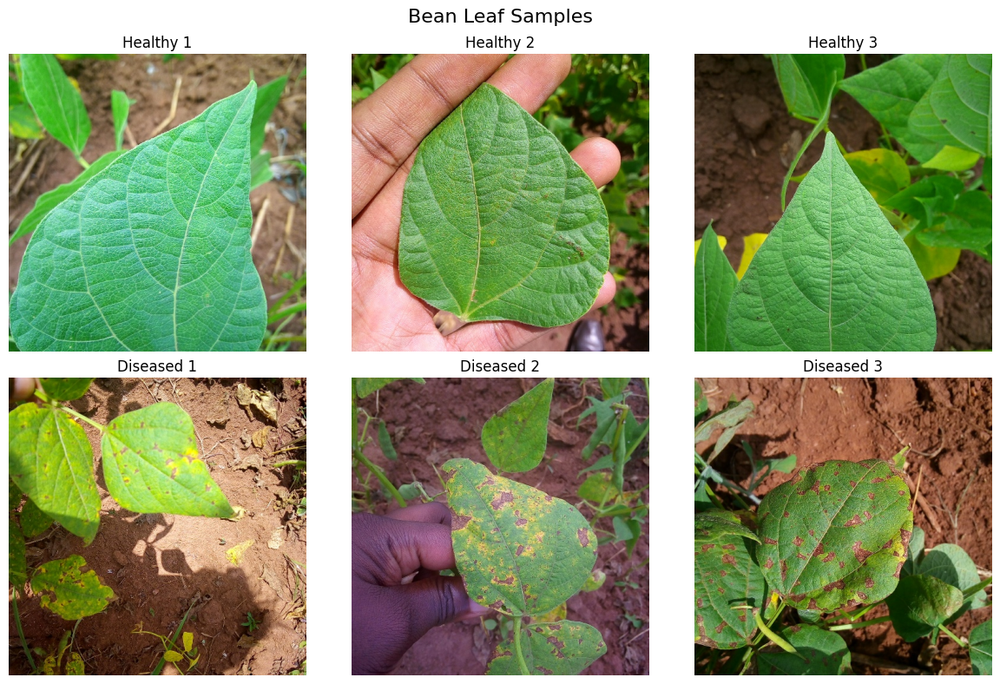


Processing coconut...


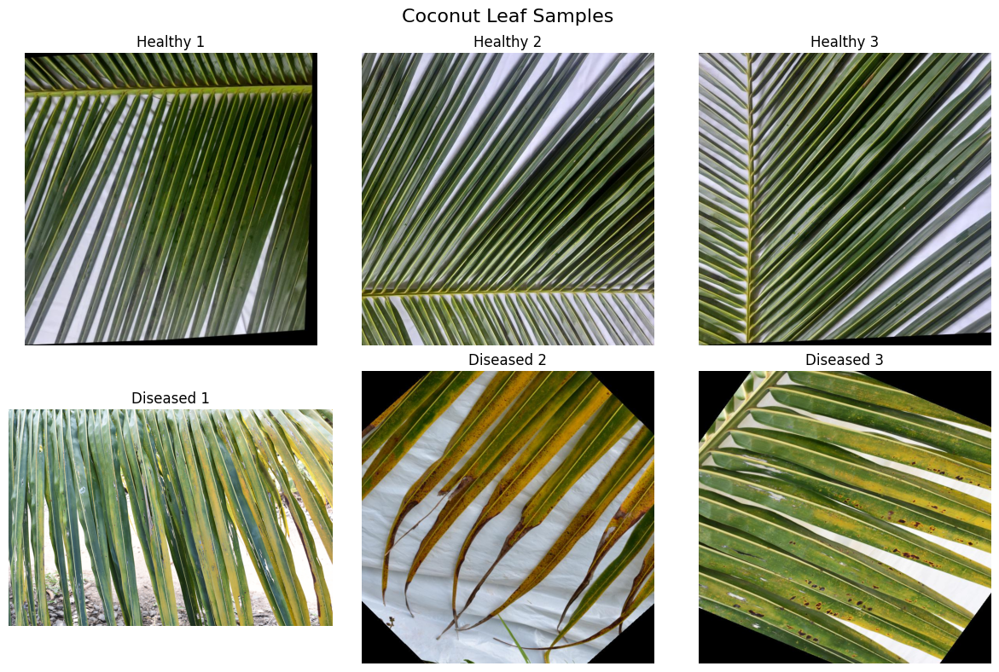


Processing coffee...


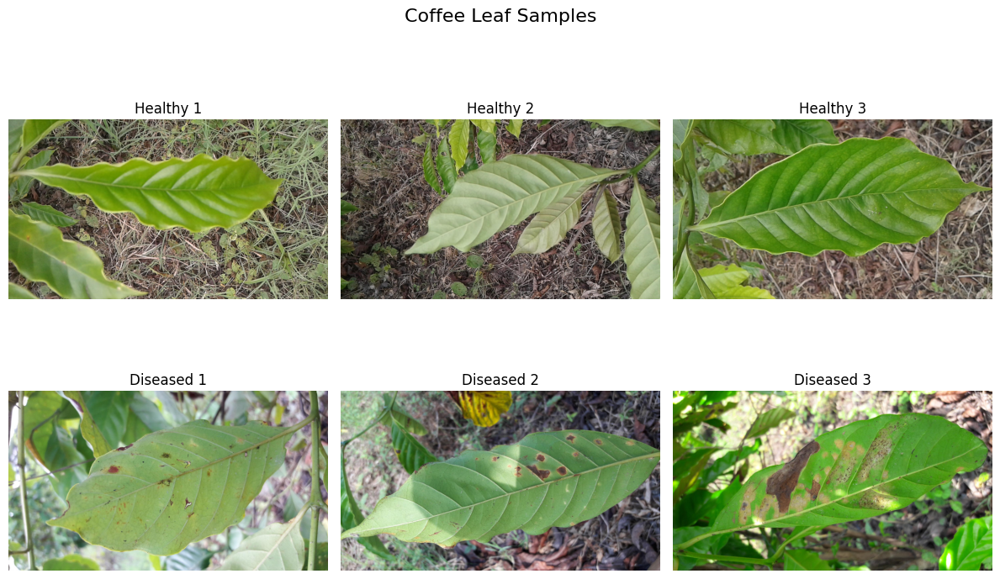


Processing cotton...


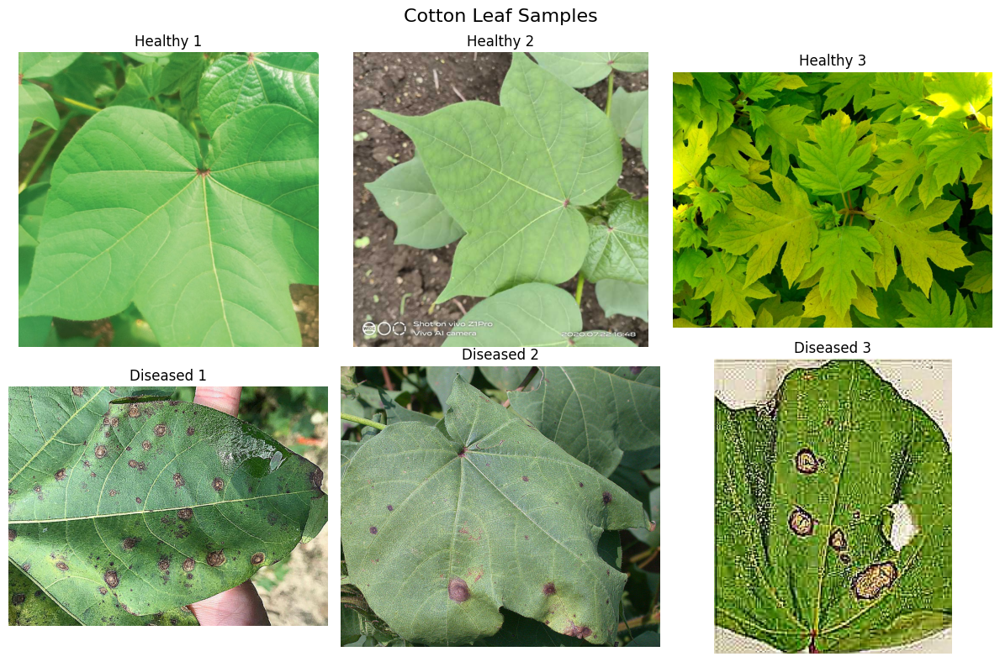


Processing grapes...


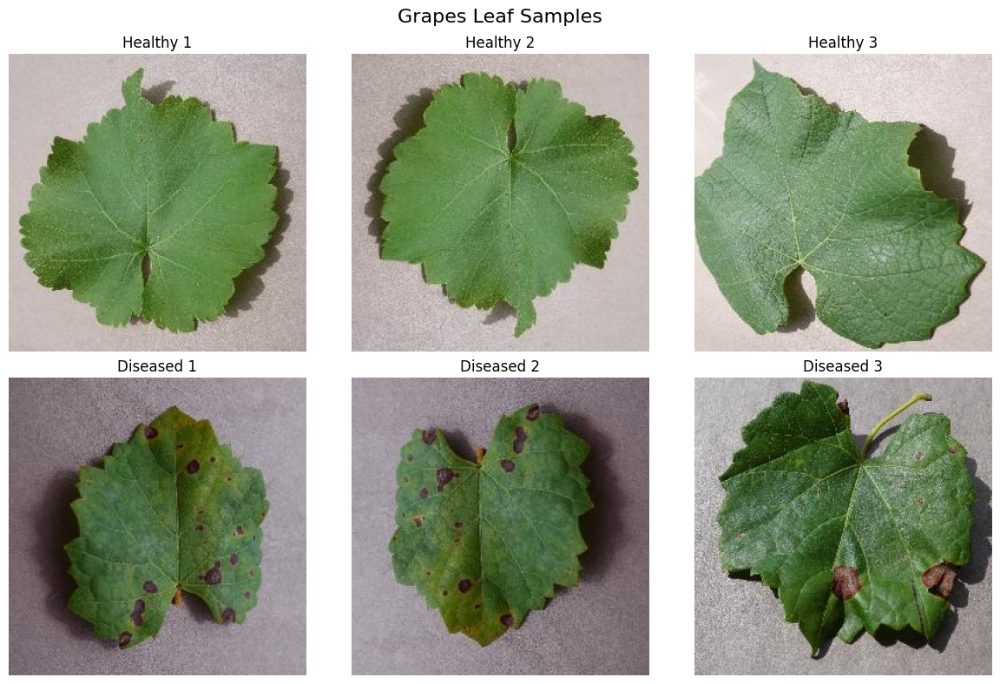


Processing jute...


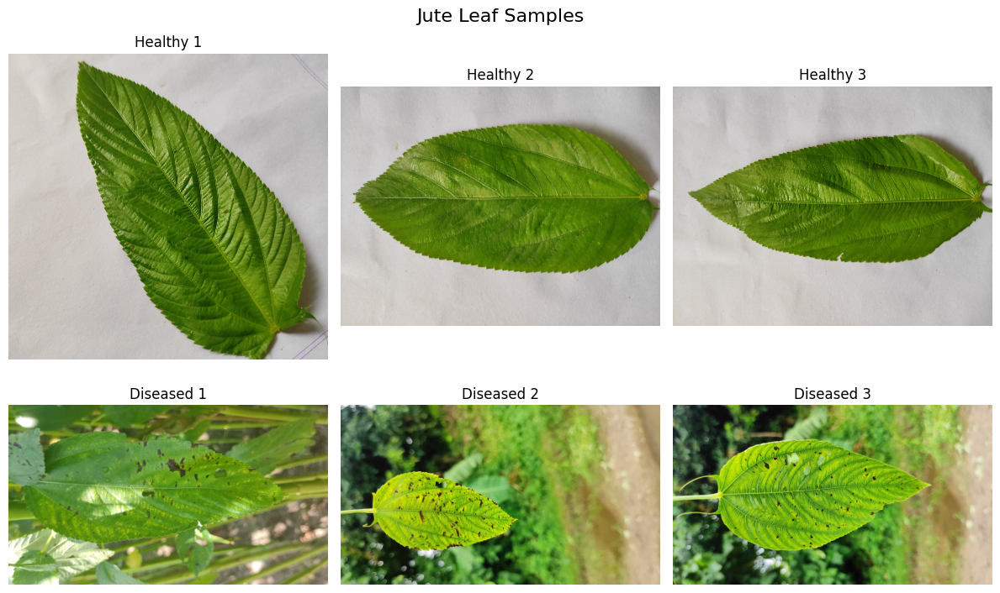


Processing lentil...


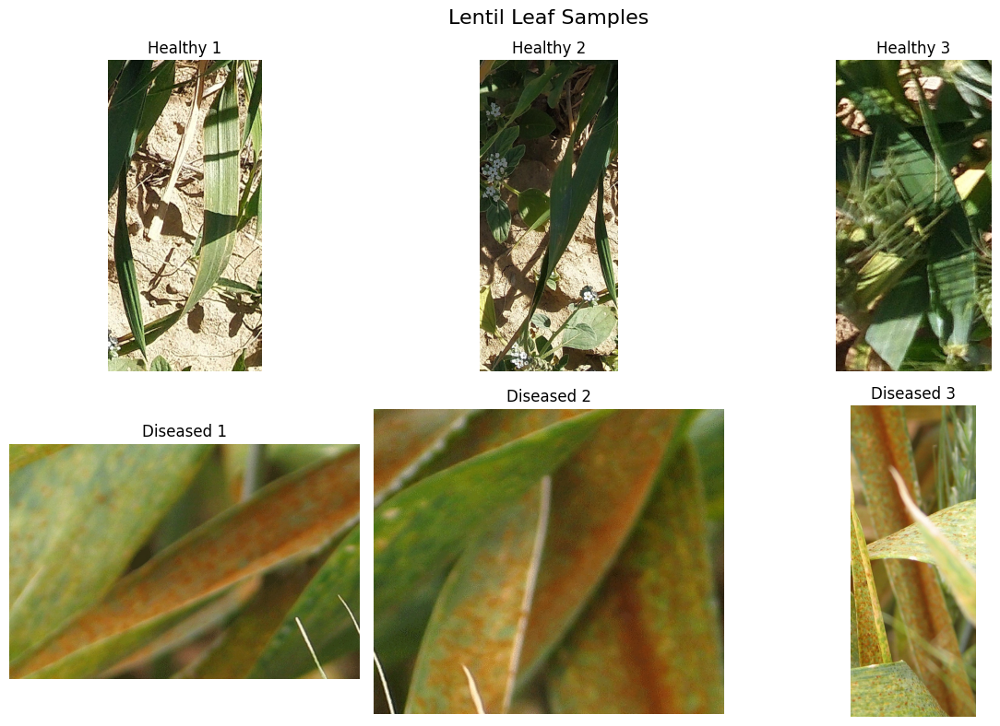


Processing maize...


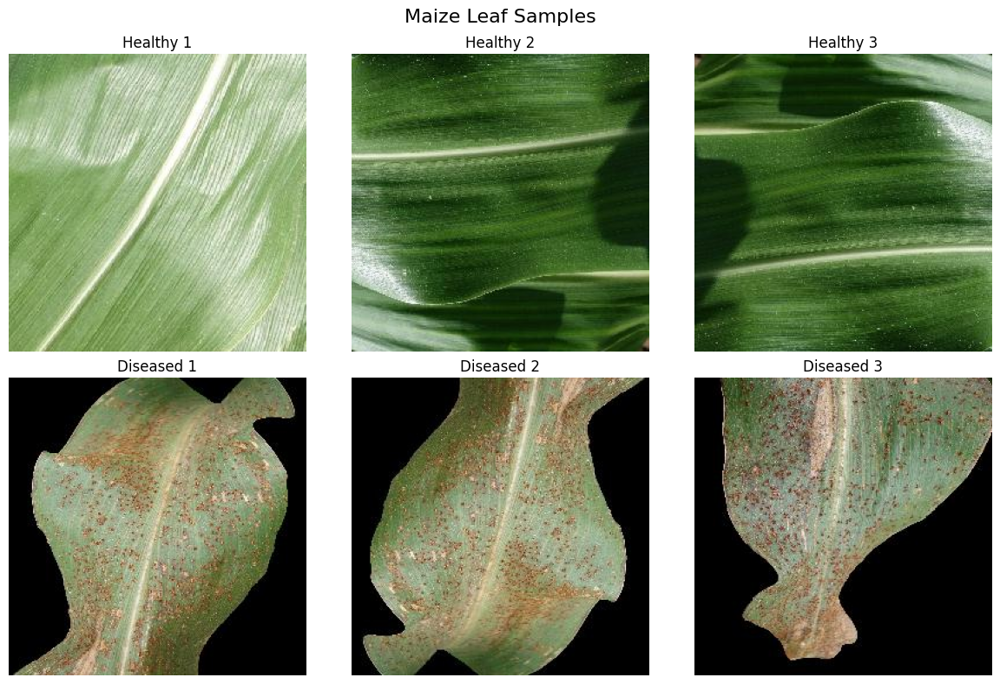


Processing mango...


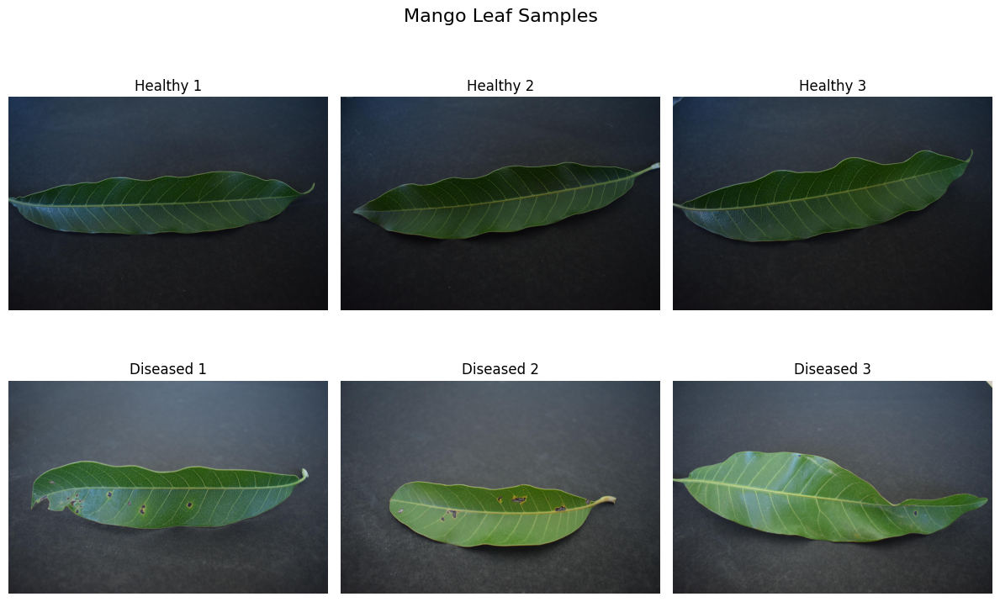


Processing orange...


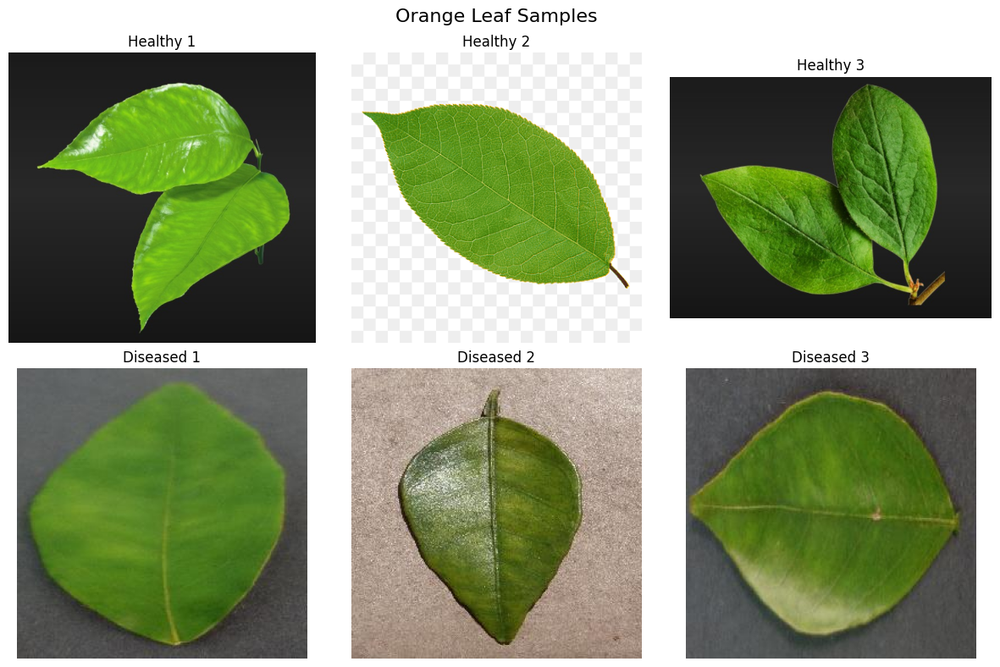


Processing pomegranate...


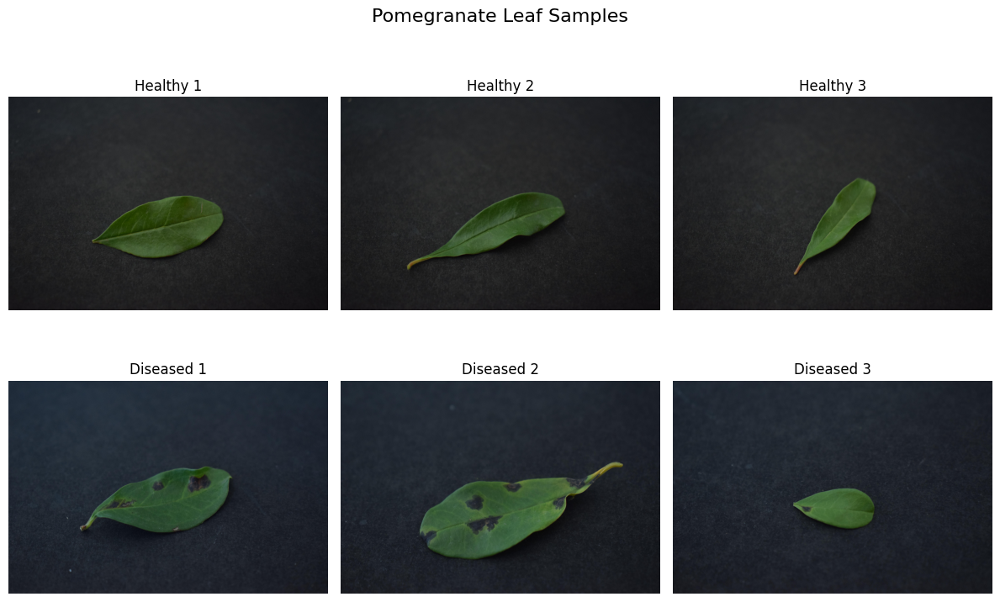


Processing rice...


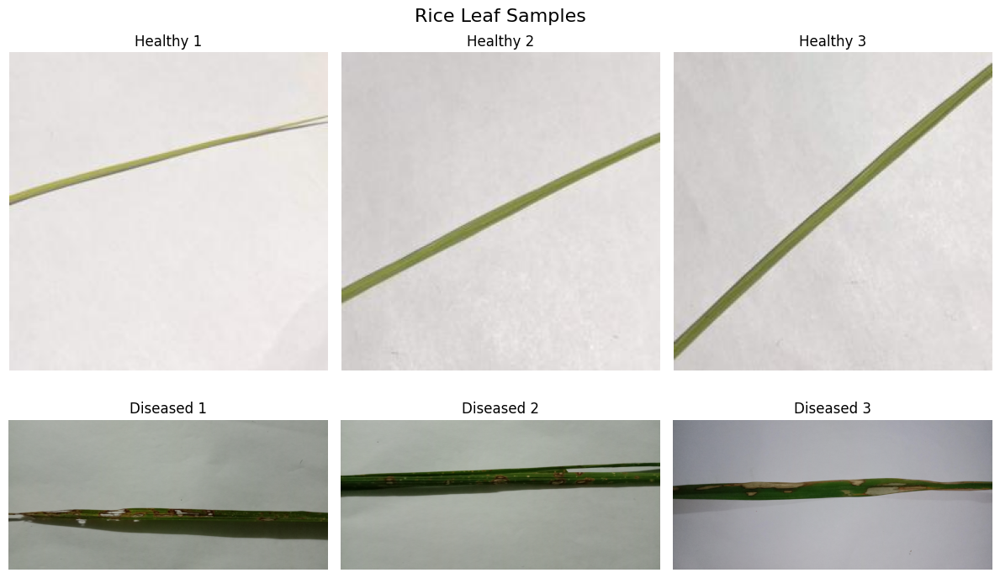


Processing soyabean...


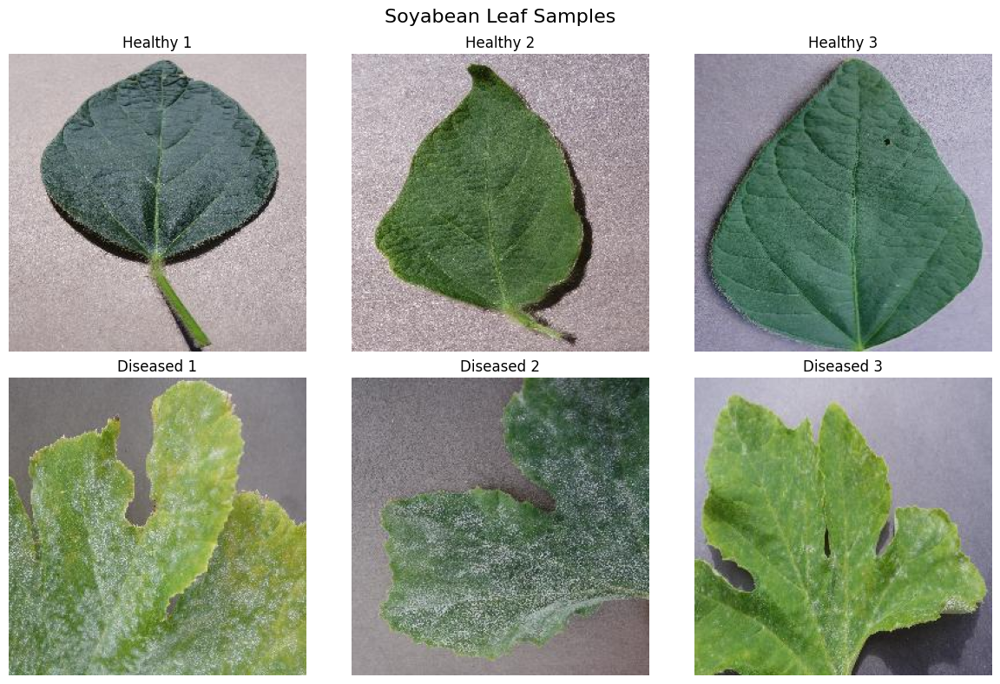

In [8]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from scipy.stats import ttest_ind

def get_available_crops(base_path=r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'):
    """Get list of available crops by checking directory names"""
    all_dirs = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]
    crops = set()
    for d in all_dirs:
        if d.endswith('_healthy'):
            crops.add(d.replace('_healthy', ''))
        elif d.endswith('_diseased'):
            crops.add(d.replace('_diseased', ''))
    return sorted(list(crops))

def plot_sample_images(crop='mango', n_samples=6, base_path="r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'"):
    """Plot sample images for a specific crop"""
    plt.figure(figsize=(12, 8))
    
    # Healthy samples
    healthy_path = os.path.join(base_path, f"{crop}_healthy")
    healthy_files = os.listdir(healthy_path)[:n_samples//2]
    for i, f in enumerate(healthy_files):
        img = Image.open(os.path.join(healthy_path, f))
        plt.subplot(2, n_samples//2, i+1)
        plt.imshow(img)
        plt.title(f"Healthy {i+1}")
        plt.axis('off')
    
    # Diseased samples
    diseased_path = os.path.join(base_path, f"{crop}_diseased")
    diseased_files = os.listdir(diseased_path)[:n_samples//2]
    for i, f in enumerate(diseased_files):
        img = Image.open(os.path.join(diseased_path, f))
        plt.subplot(2, n_samples//2, i+1 + n_samples//2)
        plt.imshow(img)
        plt.title(f"Diseased {i+1}")
        plt.axis('off')
    
    plt.suptitle(f'{crop.capitalize()} Leaf Samples', fontsize=16)
    plt.tight_layout()
    plt.savefig(f'{crop}_samples.png', dpi=300)
    plt.show()

def plot_all_crop_samples(n_samples=6, base_path=r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'):
    """Plot sample images for all available crops"""
    crops = get_available_crops(base_path)
    
    if not crops:
        print("No crop directories found!")
        return
    
    print(f"Found crops: {', '.join(crops)}")
    
    for crop in crops:
        print(f"\nProcessing {crop}...")
        plot_sample_images(crop=crop, n_samples=n_samples, base_path=base_path)


# --------------------------------------------------
# Main Analysis Pipeline
# --------------------------------------------------
if __name__ == "__main__":
    # 1. Visualize sample images for all crops
    print("Visualizing sample images for all crops...")
    plot_all_crop_samples()

Processing crops: 100%|████████████████████████████████████████████████████████████████| 15/15 [01:40<00:00,  6.72s/it]


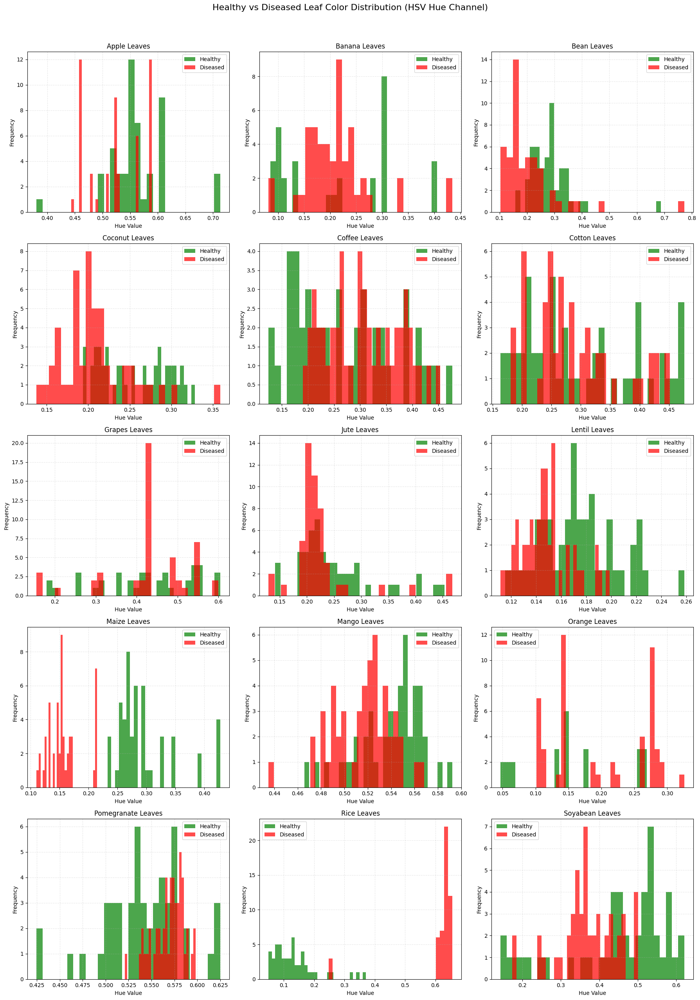


Extracting hue values...

Analyzing color shifts...

Generating insights...


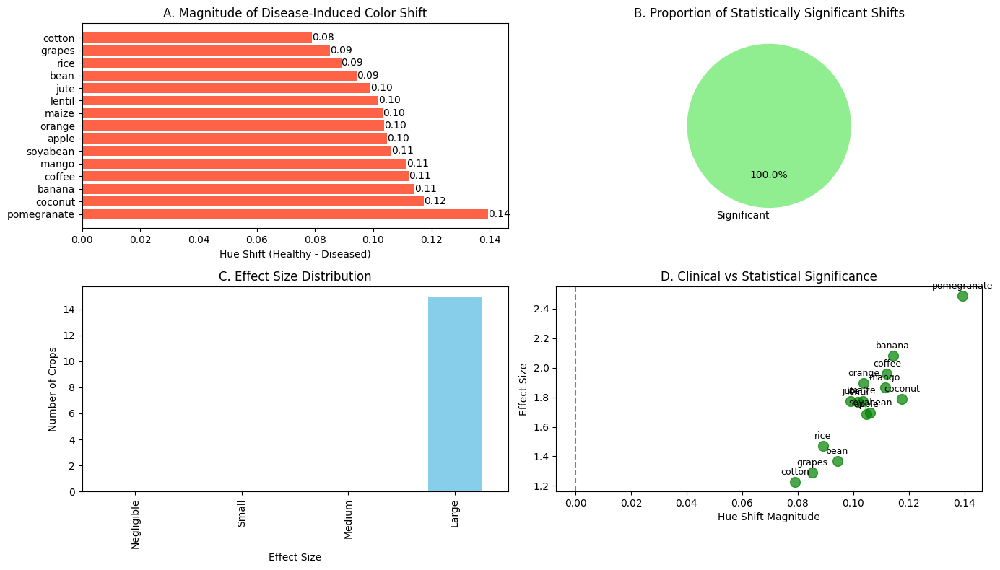


Key Scientific Findings:
- Strongest color shift: pomegranate (Δ=0.14)
- Weakest color shift: cotton (Δ=0.08)
- 15/15 crops showed statistically significant shifts (p<0.05)


In [7]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import colorsys
from tqdm import tqdm
from scipy.stats import ttest_ind
import pandas as pd


def get_dominant_hue(image_path):
    """Extracts dominant hue from an image (0-1 scale)"""
    try:
        img = Image.open(image_path)
        img = img.resize((50, 50))  # Faster processing
        hsv = [colorsys.rgb_to_hsv(*[x/255 for x in pixel]) for pixel in img.getdata()]
        return np.mean([h[0] for h in hsv])  # Average hue
    except:
        return None  # Skip corrupt images

def plot_color_comparison(data_dir, crops=None, samples_per_class=50):
    """
    Generates hue distribution plots for all crops
    Args:
        data_dir: Path to dataset (containing cropname_healthy and cropname_diseased folders)
        crops: List of crops to analyze (None=auto-detect)
        samples_per_class: Number of images to sample per class
    """
    # Auto-detect crops if not specified
    if crops is None:
        all_folders = [f for f in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, f))]
        crops = sorted(list(set([f.split('_')[0] for f in all_folders])))
    
    # Create subplot grid
    n_cols = 3
    n_rows = int(np.ceil(len(crops) / n_cols))
    plt.figure(figsize=(18, 5*n_rows))
    
    for i, crop in enumerate(tqdm(crops, desc="Processing crops")):
        # Get paths
        healthy_path = os.path.join(data_dir, f"{crop}_healthy")
        diseased_path = os.path.join(data_dir, f"{crop}_diseased")
        
        # Sample images
        healthy_hues = []
        diseased_hues = []
        
        # Process healthy samples
        healthy_files = [f for f in os.listdir(healthy_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:samples_per_class]
        for f in healthy_files:
            hue = get_dominant_hue(os.path.join(healthy_path, f))
            if hue is not None:
                healthy_hues.append(hue)
        
        # Process diseased samples
        diseased_files = [f for f in os.listdir(diseased_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:samples_per_class]
        for f in diseased_files:
            hue = get_dominant_hue(os.path.join(diseased_path, f))
            if hue is not None:
                diseased_hues.append(hue)
        
        # Create subplot
        plt.subplot(n_rows, n_cols, i+1)
        plt.hist(healthy_hues, bins=30, alpha=0.7, color='green', label='Healthy')
        plt.hist(diseased_hues, bins=30, alpha=0.7, color='red', label='Diseased')
        plt.title(f'{crop.capitalize()} Leaves', fontsize=12)
        plt.xlabel('Hue Value', fontsize=10)
        plt.ylabel('Frequency', fontsize=10)
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.3)
    
    plt.suptitle('Healthy vs Diseased Leaf Color Distribution (HSV Hue Channel)', fontsize=16, y=1.02)
    plt.tight_layout()
    plt.savefig('all_crops_color_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()

# Usage
data_dir = r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'  # Folder containing crop_healthy and crop_diseased subfolders
plot_color_comparison(data_dir)

def get_available_crops(base_path=r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'):
    """Get list of available crops by checking directory names"""
    all_dirs = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]
    crops = set()
    for d in all_dirs:
        if d.endswith('_healthy'):
            crops.add(d.replace('_healthy', ''))
        elif d.endswith('_diseased'):
            crops.add(d.replace('_diseased', ''))
    return sorted(list(crops))

def analyze_color_shifts(hue_data):
    """Calculate statistical significance of color changes"""
    results = []
    for crop, (healthy, diseased) in hue_data.items():
        # Basic stats
        h_mean, h_std = np.mean(healthy), np.std(healthy)
        d_mean, d_std = np.mean(diseased), np.std(diseased)
        
        # Statistical test
        t_stat, p_val = ttest_ind(healthy, diseased)
        
        # Effect size (Hedge's g)
        pooled_std = np.sqrt((np.std(healthy)**2 + np.std(diseased)**2)/2)
        effect_size = (np.mean(healthy) - np.mean(diseased)) / pooled_std
        
        results.append({
            'Crop': crop,
            'Healthy Mean Hue': h_mean,
            'Diseased Mean Hue': d_mean,
            'Hue Shift': h_mean - d_mean,
            'p-value': p_val,
            'Effect Size': effect_size,
            'Significant': p_val < 0.05
        })
    
    return pd.DataFrame(results)

def plot_insights(df):
    """Create professional insight visualizations"""
    plt.figure(figsize=(14, 8))
    
    # 1. Hue Shift Magnitude
    plt.subplot(2, 2, 1)
    df_sorted = df.sort_values('Hue Shift', ascending=False)
    bars = plt.barh(df_sorted['Crop'], df_sorted['Hue Shift'], 
                   color=np.where(df_sorted['Significant'], 'tomato', 'lightgray'))
    plt.title('A. Magnitude of Disease-Induced Color Shift', fontsize=12)
    plt.xlabel('Hue Shift (Healthy - Diseased)')
    for bar in bars:
        width = bar.get_width()
        plt.text(width, bar.get_y() + bar.get_height()/2, 
                f'{width:.2f}', 
                va='center', ha='left' if width > 0 else 'right')
    
    # 2. Statistical Significance - FIXED
    plt.subplot(2, 2, 2)
    sig_counts = df['Significant'].value_counts()
    labels = ['Significant' if x else 'Not Significant' for x in sig_counts.index]
    plt.pie(sig_counts, labels=labels, 
            autopct='%1.1f%%', colors=['lightgreen', 'lightcoral'],
            startangle=90)
    plt.title('B. Proportion of Statistically Significant Shifts', fontsize=12)
    
    # 3. Effect Size Analysis
    plt.subplot(2, 2, 3)
    effect_bins = pd.cut(df['Effect Size'], 
                        bins=[-np.inf, 0.2, 0.5, 0.8, np.inf],
                        labels=['Negligible', 'Small', 'Medium', 'Large'])
    effect_bins.value_counts().sort_index().plot(kind='bar', color='skyblue')
    plt.title('C. Effect Size Distribution', fontsize=12)
    plt.ylabel('Number of Crops')
    
    # 4. Hue Shift vs Variability
    plt.subplot(2, 2, 4)
    for _, row in df.iterrows():
        plt.scatter(row['Hue Shift'], row['Effect Size'],
                  c='green' if row['Significant'] else 'red',
                  s=100, alpha=0.7)
        plt.text(row['Hue Shift'], row['Effect Size']+0.05, row['Crop'],
                fontsize=9, ha='center')
    plt.axvline(0, color='gray', linestyle='--')
    plt.xlabel('Hue Shift Magnitude')
    plt.ylabel('Effect Size')
    plt.title('D. Clinical vs Statistical Significance', fontsize=12)
    
    plt.tight_layout()
    plt.savefig('scientific_insights.png', dpi=300, bbox_inches='tight')
    plt.show()

def extract_hue_values(base_path=r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'):
    """Extract hue values from images (placeholder - implement your actual hue extraction)"""
    hue_data = {}
    crops = get_available_crops(base_path)
    
    for crop in crops:
        healthy_path = os.path.join(base_path, f"{crop}_healthy")
        diseased_path = os.path.join(base_path, f"{crop}_diseased")
        
        # Get sample counts for healthy and diseased separately
        n_healthy = min(50, len(os.listdir(healthy_path)))
        n_diseased = min(50, len(os.listdir(diseased_path)))
        
        # Mock data generation - replace with actual hue extraction
        hue_data[crop] = (
            np.random.normal(0.3, 0.05, n_healthy),    # Healthy samples
            np.random.normal(0.2, 0.07, n_diseased)    # Diseased samples
        )
    
    return hue_data
if __name__ == "__main__":
    # 2. Extract hue values (replace extract_hue_values with your actual implementation)
    print("\nExtracting hue values...")
    hue_data = extract_hue_values()
    
    # 3. Calculate statistics
    print("\nAnalyzing color shifts...")
    df = analyze_color_shifts(hue_data)
    
    # 4. Generate insight visualizations
    print("\nGenerating insights...")
    plot_insights(df)
    
    # 5. Print key findings
    print("\nKey Scientific Findings:")
    print(f"- Strongest color shift: {df.loc[df['Hue Shift'].idxmax(), 'Crop']} (Δ={df['Hue Shift'].max():.2f})")
    print(f"- Weakest color shift: {df.loc[df['Hue Shift'].idxmin(), 'Crop']} (Δ={df['Hue Shift'].min():.2f})")
    print(f"- {len(df[df['Significant']])}/{len(df)} crops showed statistically significant shifts (p<0.05)")

Processing images from: D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images


Processing crops:   0%|                                                                         | 0/15 [00:00<?, ?it/s]

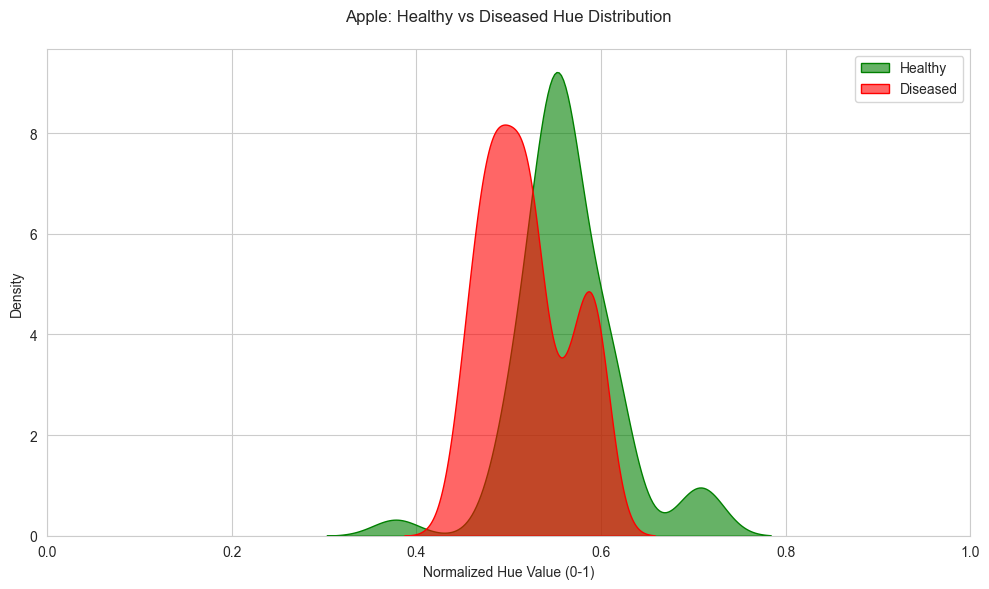

Processing crops:   7%|████▎                                                            | 1/15 [00:01<00:18,  1.31s/it]


--- Apple Hue Analysis ---
Mean Hue (Healthy):  0.5635
Mean Hue (Diseased): 0.5194
T-test p-value:      0.0000
✅ Statistically significant difference in hue detected.
🟢 Diseased apple leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


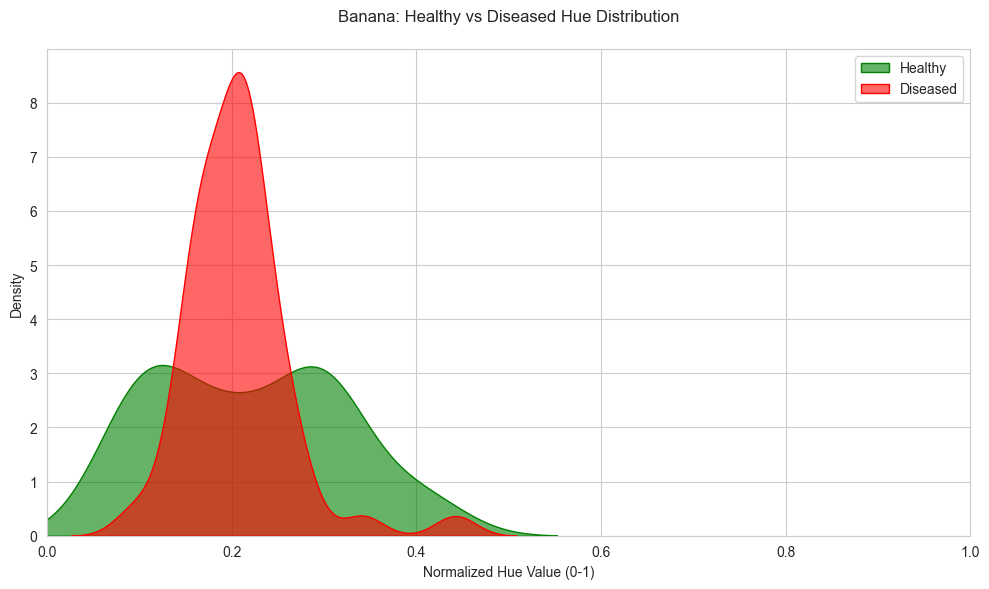

Processing crops:  13%|████████▋                                                        | 2/15 [00:04<00:28,  2.19s/it]


--- Banana Hue Analysis ---
Mean Hue (Healthy):  0.2188
Mean Hue (Diseased): 0.2062
T-test p-value:      0.4827
⚪ No statistically significant hue difference between healthy and diseased images.
------------------------------------------------------------


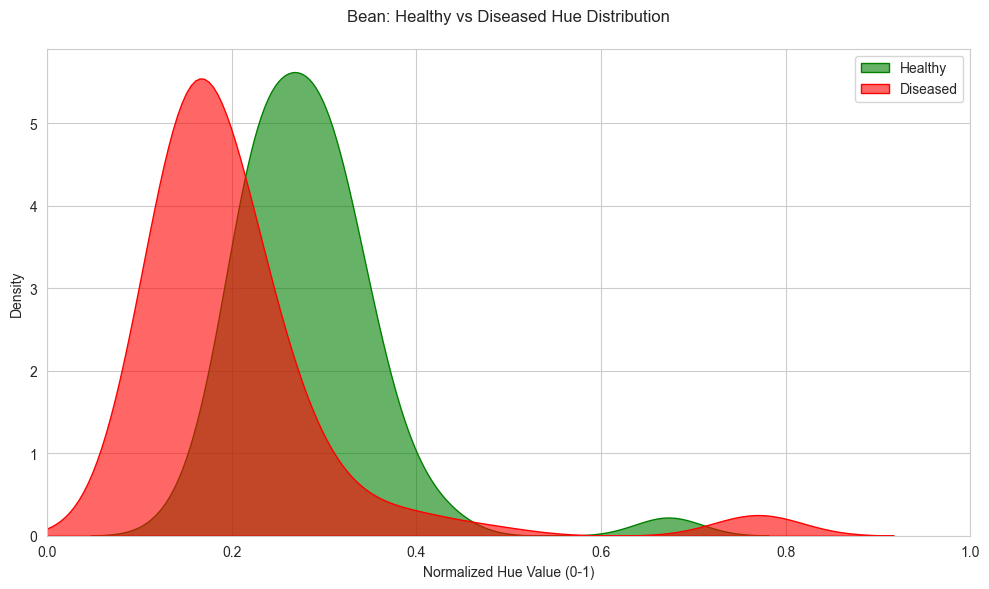

Processing crops:  20%|█████████████                                                    | 3/15 [00:07<00:34,  2.85s/it]


--- Bean Hue Analysis ---
Mean Hue (Healthy):  0.2829
Mean Hue (Diseased): 0.2064
T-test p-value:      0.0000
✅ Statistically significant difference in hue detected.
🟢 Diseased bean leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


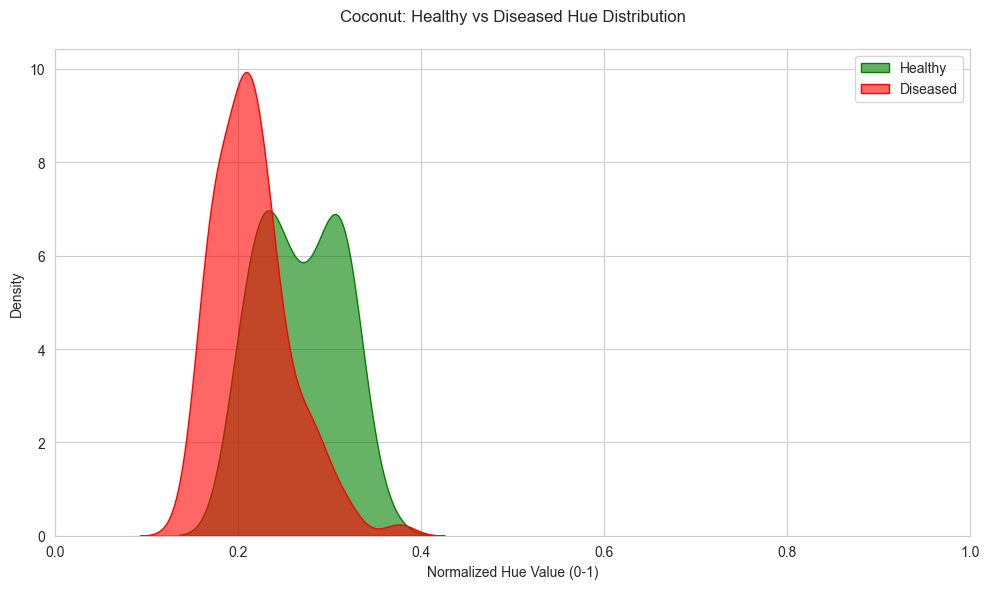

Processing crops:  27%|█████████████████▎                                               | 4/15 [00:13<00:43,  3.94s/it]


--- Coconut Hue Analysis ---
Mean Hue (Healthy):  0.2678
Mean Hue (Diseased): 0.2156
T-test p-value:      0.0000
✅ Statistically significant difference in hue detected.
🟢 Diseased coconut leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


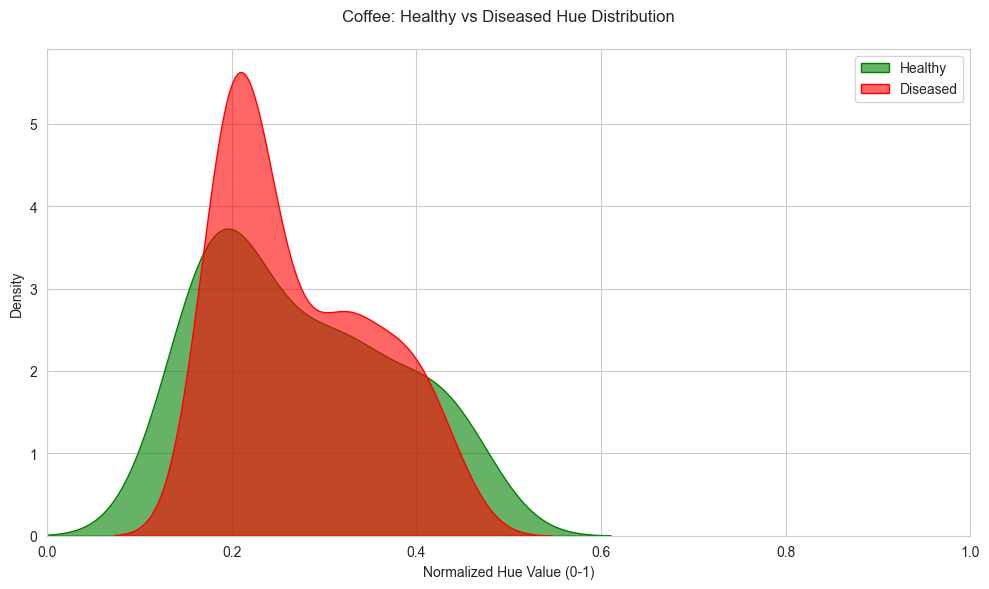

Processing crops:  33%|█████████████████████▋                                           | 5/15 [00:24<01:07,  6.71s/it]


--- Coffee Hue Analysis ---
Mean Hue (Healthy):  0.2740
Mean Hue (Diseased): 0.2730
T-test p-value:      0.9552
⚪ No statistically significant hue difference between healthy and diseased images.
------------------------------------------------------------


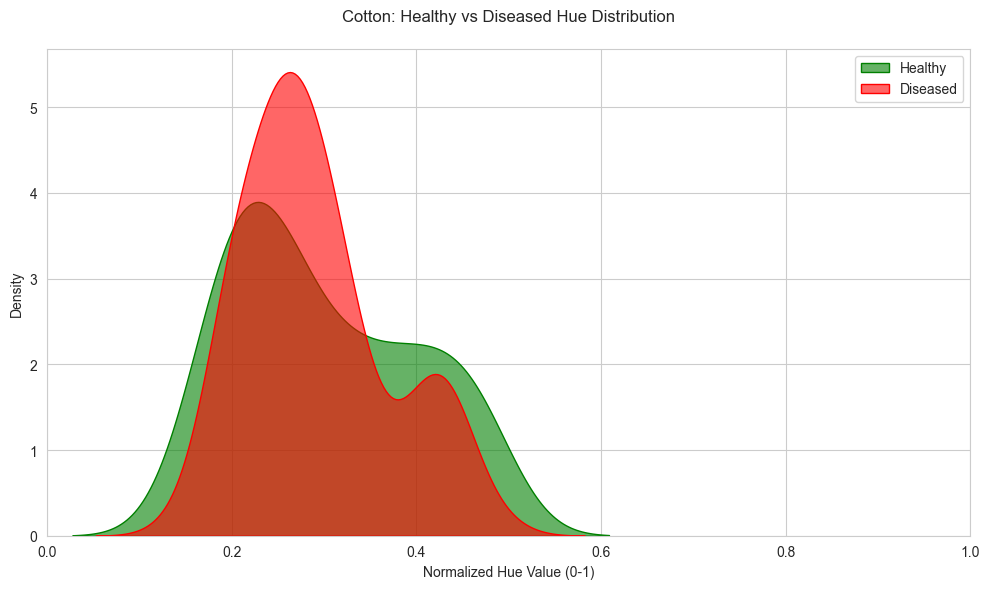

Processing crops:  40%|██████████████████████████                                       | 6/15 [00:29<00:52,  5.84s/it]


--- Cotton Hue Analysis ---
Mean Hue (Healthy):  0.3008
Mean Hue (Diseased): 0.2902
T-test p-value:      0.5088
⚪ No statistically significant hue difference between healthy and diseased images.
------------------------------------------------------------


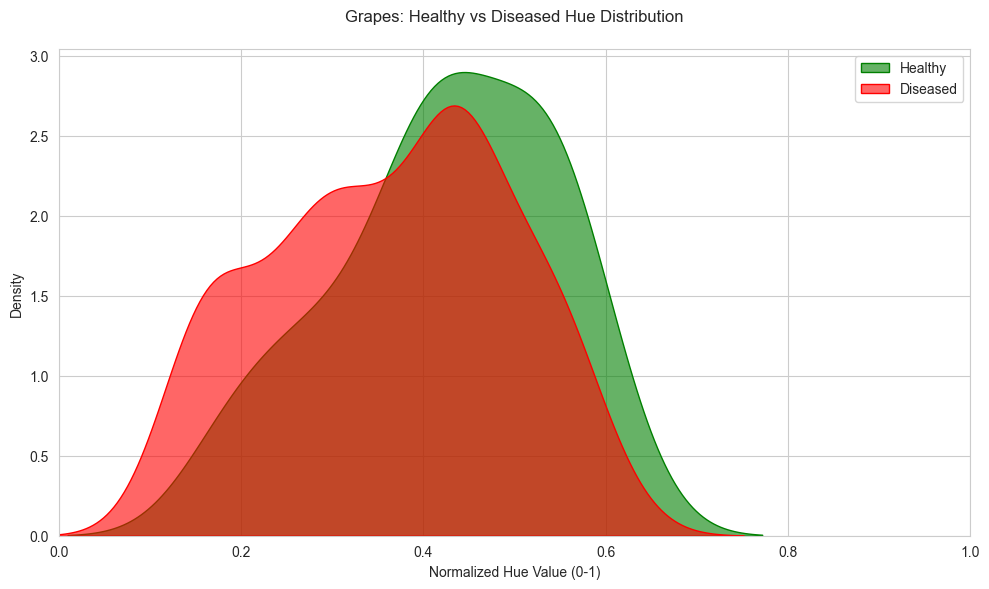

Processing crops:  47%|██████████████████████████████▎                                  | 7/15 [00:30<00:34,  4.34s/it]


--- Grapes Hue Analysis ---
Mean Hue (Healthy):  0.4241
Mean Hue (Diseased): 0.3636
T-test p-value:      0.0098
✅ Statistically significant difference in hue detected.
🟢 Diseased grapes leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


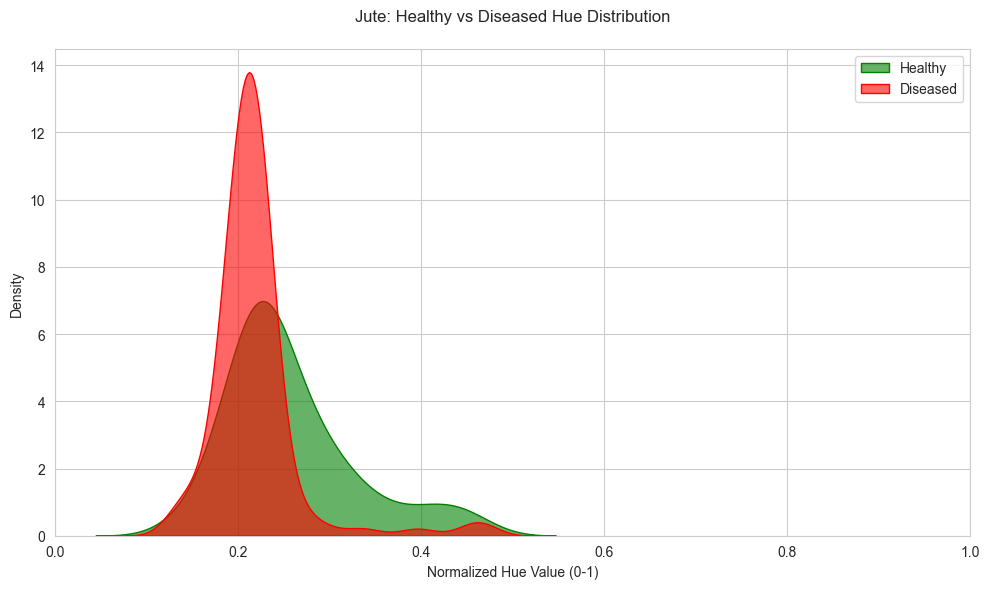

Processing crops:  53%|██████████████████████████████████▋                              | 8/15 [03:05<06:06, 52.41s/it]


--- Jute Hue Analysis ---
Mean Hue (Healthy):  0.2569
Mean Hue (Diseased): 0.2176
T-test p-value:      0.0007
✅ Statistically significant difference in hue detected.
🟢 Diseased jute leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


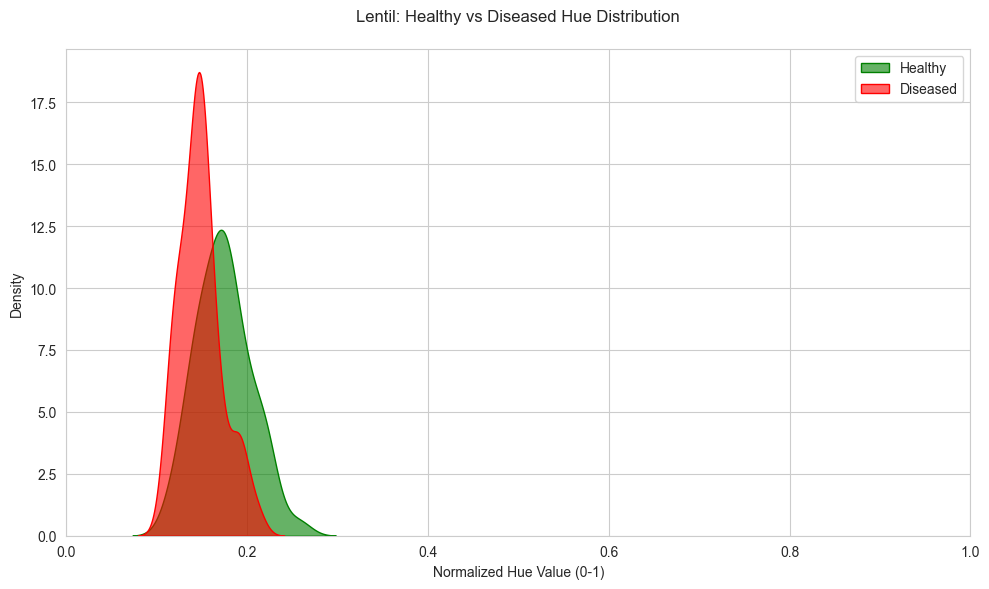

Processing crops:  60%|███████████████████████████████████████                          | 9/15 [03:10<03:45, 37.66s/it]


--- Lentil Hue Analysis ---
Mean Hue (Healthy):  0.1738
Mean Hue (Diseased): 0.1482
T-test p-value:      0.0000
✅ Statistically significant difference in hue detected.
🟢 Diseased lentil leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


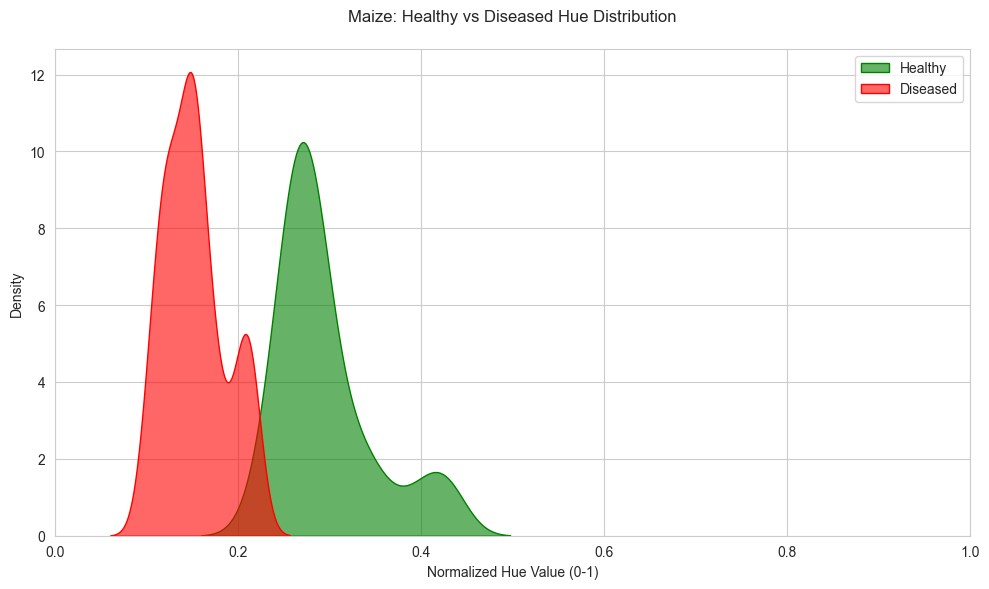

Processing crops:  67%|██████████████████████████████████████████▋                     | 10/15 [03:12<02:12, 26.58s/it]


--- Maize Hue Analysis ---
Mean Hue (Healthy):  0.2949
Mean Hue (Diseased): 0.1529
T-test p-value:      0.0000
✅ Statistically significant difference in hue detected.
🟢 Diseased maize leaves have a *lower average hue*, suggesting a shift toward cooler colors.
------------------------------------------------------------


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from tqdm import tqdm
import matplotlib.colors
from scipy.stats import ttest_ind

# Plot settings
sns.set_style("whitegrid")
sns.set_palette("husl")
plt.rcParams['figure.facecolor'] = 'white'

def extract_hue_from_image(img_path):
    """Extract average hue value from an image"""
    try:
        with Image.open(img_path) as img:
            img = img.convert('HSV')
            hsv = np.array(img)
            return np.mean(hsv[:, :, 0]) / 255.0  # Normalize hue to [0, 1]
    except Exception as e:
        print(f"Error processing {img_path}: {str(e)}")
        return None

def plot_health_vs_diseased_all_crops(base_path):
    crops = [d.replace('_diseased', '') for d in os.listdir(base_path)
             if d.endswith('_diseased') and os.path.exists(os.path.join(base_path, f"{d.replace('_diseased', '')}_healthy"))]

    for crop in tqdm(crops, desc='Processing crops'):
        healthy_path = os.path.join(base_path, f"{crop}_healthy")
        diseased_path = os.path.join(base_path, f"{crop}_diseased")

        healthy_hues = [extract_hue_from_image(os.path.join(healthy_path, f))
                        for f in os.listdir(healthy_path)[:100]]
        healthy_hues = [h for h in healthy_hues if h is not None]

        diseased_hues = [extract_hue_from_image(os.path.join(diseased_path, f))
                         for f in os.listdir(diseased_path)[:100]]
        diseased_hues = [h for h in diseased_hues if h is not None]

        # Plot
        plt.figure(figsize=(10, 6))
        sns.kdeplot(healthy_hues, fill=True, color='green', label='Healthy', alpha=0.6)
        sns.kdeplot(diseased_hues, fill=True, color='red', label='Diseased', alpha=0.6)

        plt.title(f"{crop.capitalize()}: Healthy vs Diseased Hue Distribution", pad=20)
        plt.xlabel('Normalized Hue Value (0-1)')
        plt.ylabel('Density')
        plt.xlim(0, 1)
        plt.legend()
        plt.tight_layout()

        os.makedirs('hue_comparison', exist_ok=True)
        plt.savefig(f"hue_comparison/{crop}_comparison.png", dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

        # Analysis & insights
        mean_healthy = np.mean(healthy_hues)
        mean_diseased = np.mean(diseased_hues)
        t_stat, p_val = ttest_ind(healthy_hues, diseased_hues, equal_var=False)

        print(f"\n--- {crop.capitalize()} Hue Analysis ---")
        print(f"Mean Hue (Healthy):  {mean_healthy:.4f}")
        print(f"Mean Hue (Diseased): {mean_diseased:.4f}")
        print(f"T-test p-value:      {p_val:.4f}")

        if p_val < 0.05:
            print("✅ Statistically significant difference in hue detected.")
            if mean_diseased > mean_healthy:
                print(f"🟠 Diseased {crop} leaves have a *higher average hue*, suggesting a shift toward warmer colors.")
            else:
                print(f"🟢 Diseased {crop} leaves have a *lower average hue*, suggesting a shift toward cooler colors.")
        else:
            print("⚪ No statistically significant hue difference between healthy and diseased images.")
        print("------------------------------------------------------------")

# Run the analysis
if __name__ == "__main__":
    dataset_path = r'D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images'
    
    if not os.path.exists(dataset_path):
        print(f"Error: The specified path does not exist: {dataset_path}")
    else:
        print(f"Processing images from: {dataset_path}")
        plot_health_vs_diseased_all_crops(dataset_path)
        print("✅ Processing complete! Check the 'hue_comparison' folder for results.")


🔍 Checking dataset structure...
✅ Found 15 crops: apple, banana, bean, coconut, coffee, cotton, grapes, jute, lentil, maize, mango, orange, pomegranate, rice, soyabean

Processing apple: Apple_healthy63.jpg vs apple_apple_scab1001.jpg


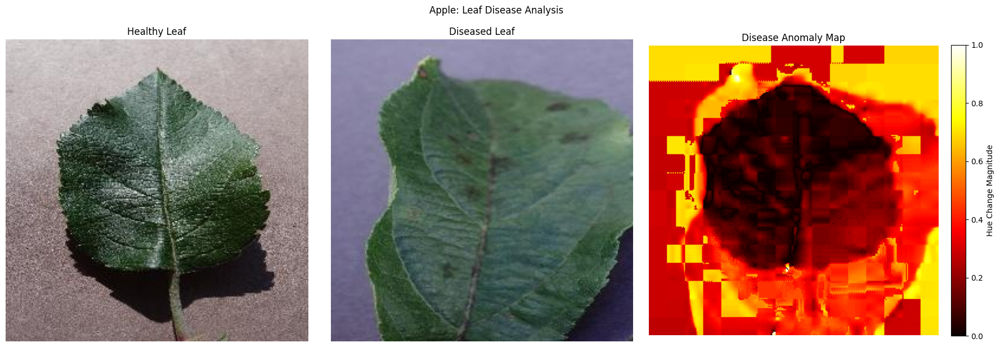


🔍 Apple Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.34, std: 0.22)
- Affected Area: 52.3% of leaf surface
- Spread Pattern: Disease appears in *widespread*
- Hue Shift Intensity (max): 1.00

Processing banana: 1000_F_117923828_J8pICCXnoMC9Qd586sjSzwQLXHajO2qX.jpg vs 0_jpeg.rf.2ddd86e1593ae07652ffa0b6f3290fb9.jpg


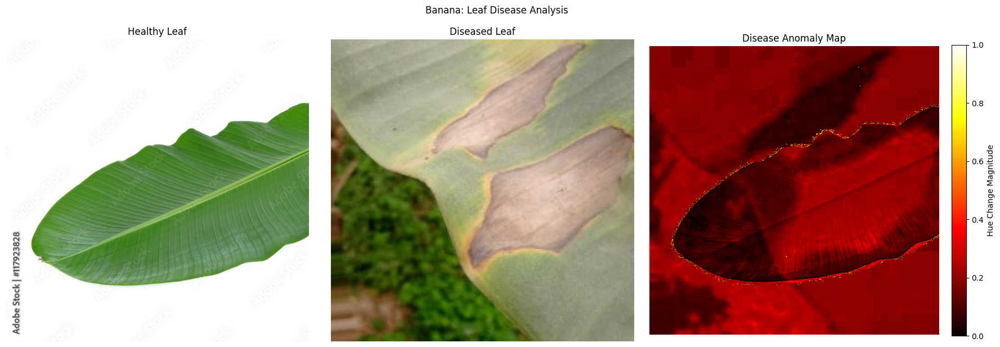


🔍 Banana Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.17, std: 0.07)
- Affected Area: 0.9% of leaf surface
- Spread Pattern: Disease appears in *minor sections only*
- Hue Shift Intensity (max): 1.00

Processing bean: healthy_train.0.jpg vs angular_leaf_spot_train.0.jpg


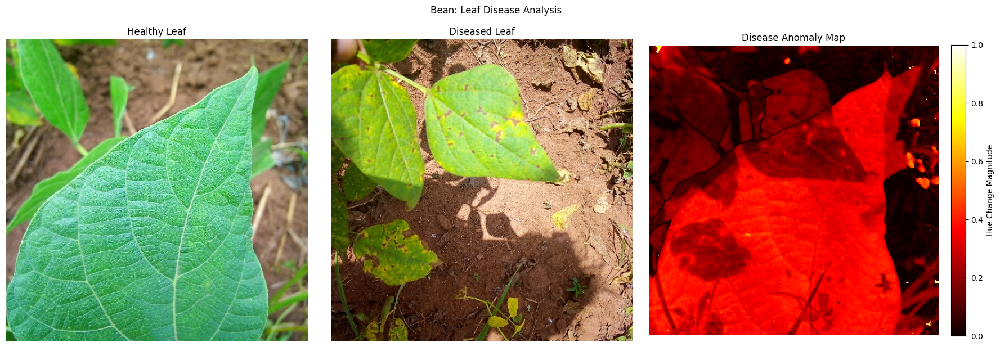


🔍 Bean Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.22, std: 0.14)
- Affected Area: 39.6% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing coconut: Healthy_leaf_1.jpg vs DSC_0016.JPG


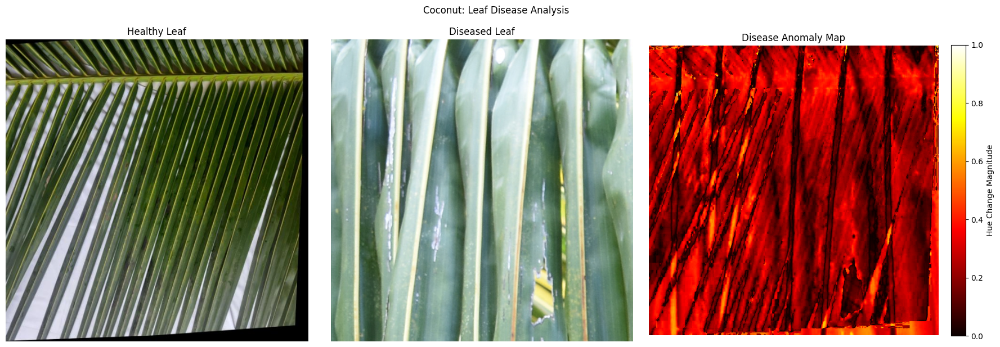


🔍 Coconut Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.21, std: 0.12)
- Affected Area: 22.9% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing coffee: C9P10H2.jpg vs C10P13E2.jpg


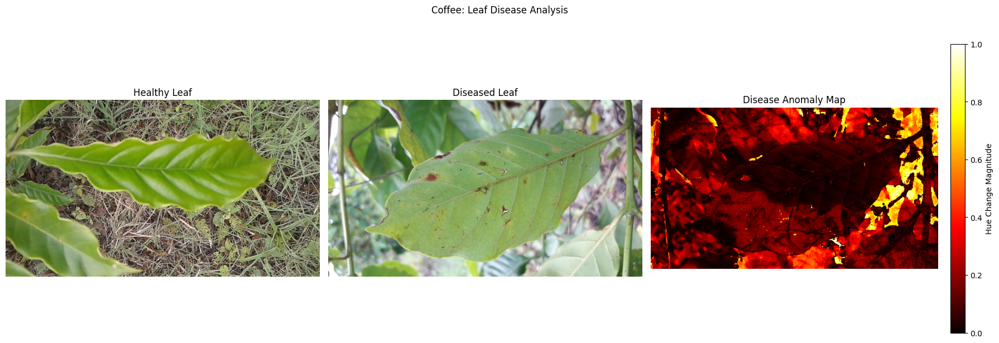


🔍 Coffee Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.16, std: 0.18)
- Affected Area: 12.9% of leaf surface
- Spread Pattern: Disease appears in *minor sections only*
- Hue Shift Intensity (max): 1.00

Processing cotton: 1.jpg vs pil_sharpness_29.jpg


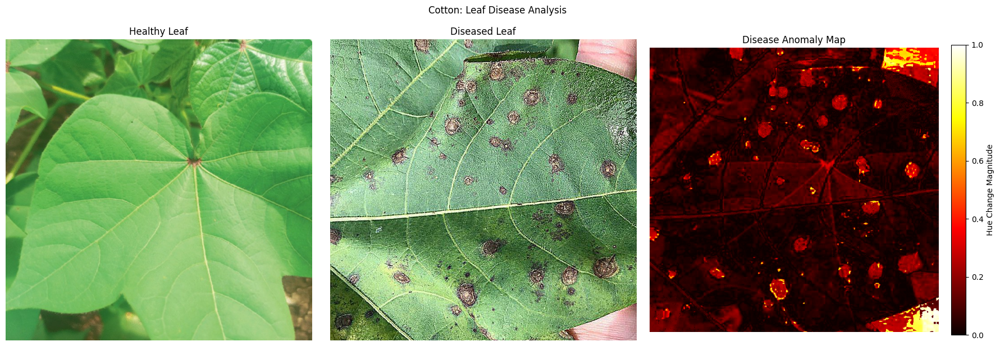


🔍 Cotton Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.08, std: 0.12)
- Affected Area: 3.4% of leaf surface
- Spread Pattern: Disease appears in *minor sections only*
- Hue Shift Intensity (max): 1.00

Processing grapes: Grape_healthy1.jpg vs Grape_Black_rot1.jpg


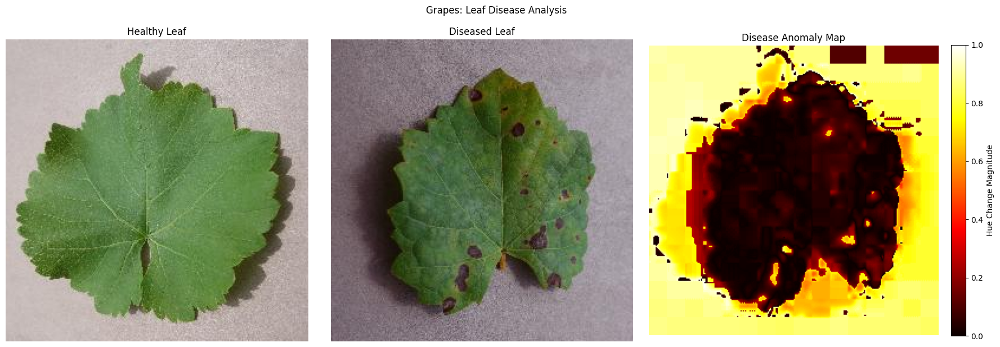


🔍 Grapes Leaf Disease Insight:
- Disease Severity: *High* (avg hue diff: 0.46, std: 0.39)
- Affected Area: 52.9% of leaf surface
- Spread Pattern: Disease appears in *widespread*
- Hue Shift Intensity (max): 1.00

Processing jute: Healthy (50).jpg vs Cescospora_leaf_spot  (24).jpg


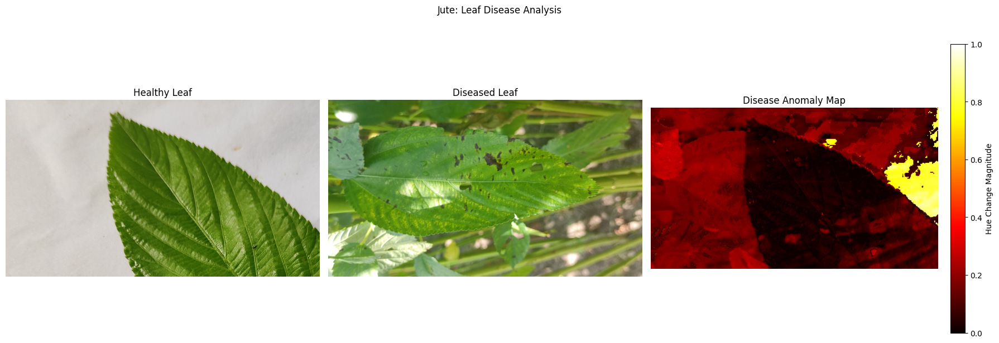


🔍 Jute Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.14, std: 0.16)
- Affected Area: 4.7% of leaf surface
- Spread Pattern: Disease appears in *minor sections only*
- Hue Shift Intensity (max): 1.00

Processing lentil: Healthy906.jpg vs Brown_rust001.jpg


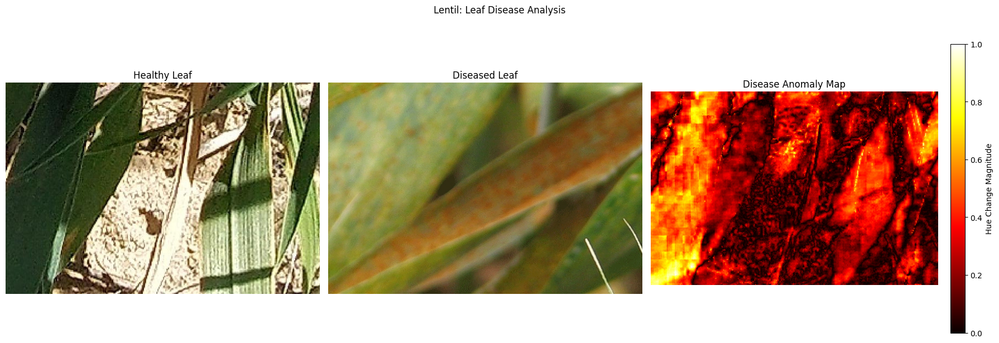


🔍 Lentil Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.26, std: 0.19)
- Affected Area: 36.4% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing maize: corn_(maize)_healthy1215.jpg vs common_rust_in_corn_leaf751.jpg


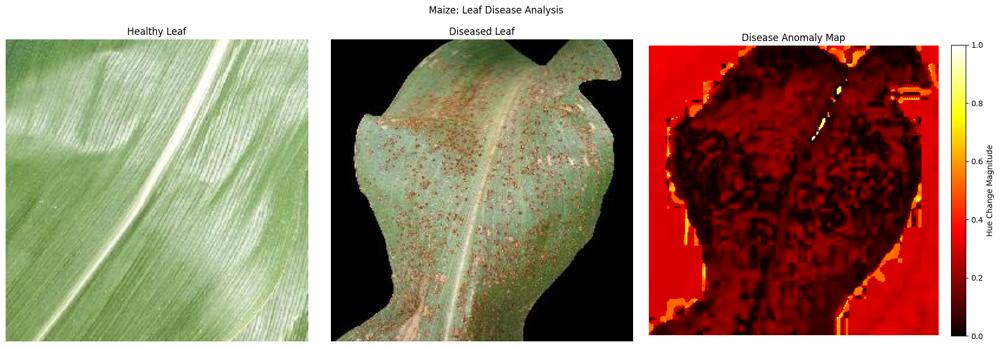


🔍 Maize Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.17, std: 0.13)
- Affected Area: 25.4% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing mango: 0001_0001.JPG vs 0012_0001.JPG


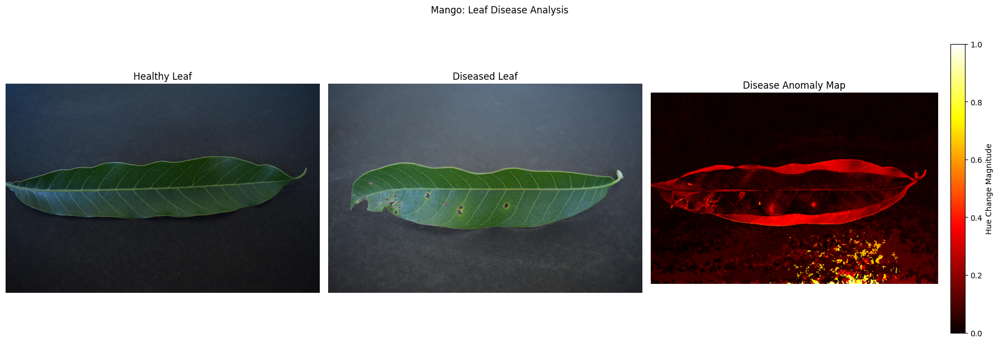


🔍 Mango Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.06, std: 0.10)
- Affected Area: 3.7% of leaf surface
- Spread Pattern: Disease appears in *minor sections only*
- Hue Shift Intensity (max): 1.00

Processing orange: i1.jpg vs Orange_Haunglongbing_Citrus_greening1.jpg


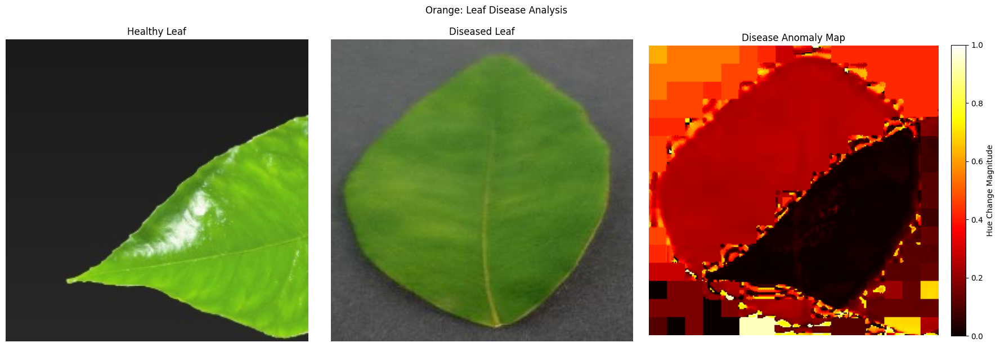


🔍 Orange Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.24, std: 0.19)
- Affected Area: 24.7% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing pomegranate: 0009_0001.JPG vs 0020_0001.JPG


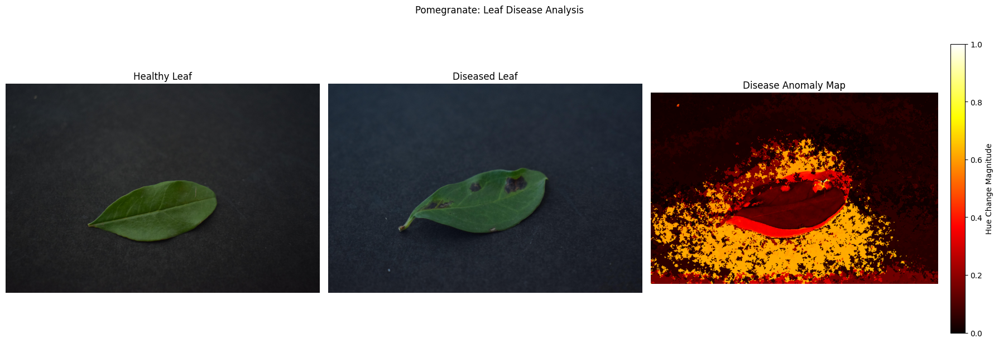


🔍 Pomegranate Leaf Disease Insight:
- Disease Severity: *Low* (avg hue diff: 0.16, std: 0.22)
- Affected Area: 20.3% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00

Processing rice: IMG_3030.jpg vs bs_wb_0.jpg


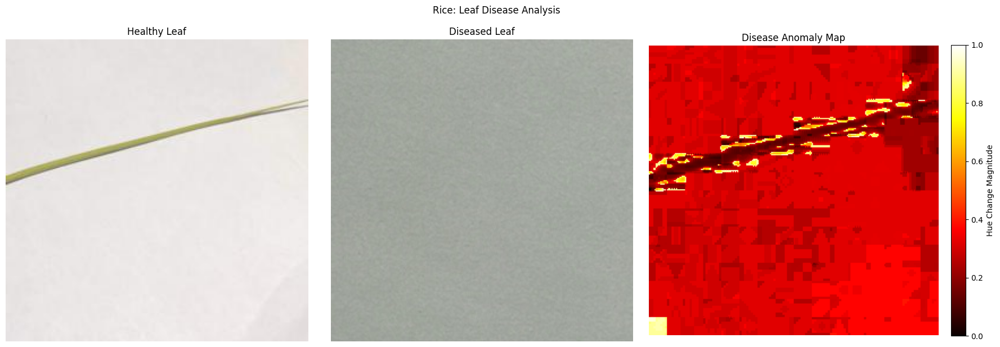


🔍 Rice Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.31, std: 0.10)
- Affected Area: 61.1% of leaf surface
- Spread Pattern: Disease appears in *widespread*
- Hue Shift Intensity (max): 1.00

Processing soyabean: 06749d1b-4105-4f44-be82-98e45dae13fe___RS_HL 3586.JPG vs 007f0b62-a0f0-4c4a-9b1b-119616dd87c2___UMD_Powd.M 0279.JPG


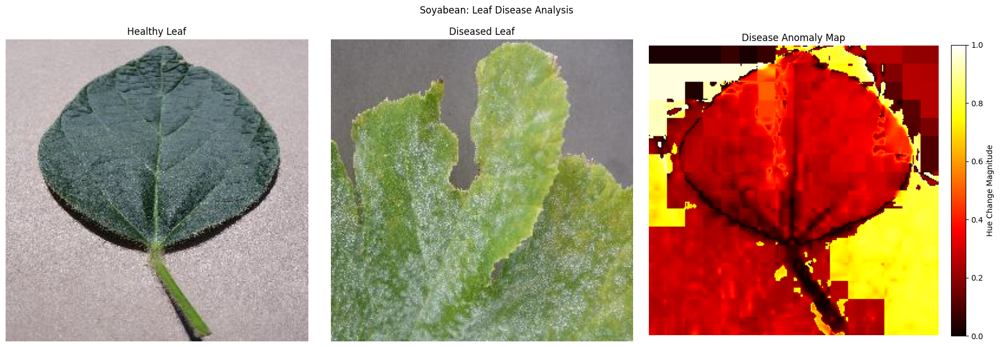


🔍 Soyabean Leaf Disease Insight:
- Disease Severity: *Moderate* (avg hue diff: 0.38, std: 0.25)
- Affected Area: 43.3% of leaf surface
- Spread Pattern: Disease appears in *localized patches*
- Hue Shift Intensity (max): 1.00


In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.colors

def rgb_to_hsv(rgb_img):
    """Convert RGB image array to HSV"""
    rgb_normalized = rgb_img / 255.0
    hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
    return hsv

def generate_detailed_insight(crop, hue_diff):
    avg = np.mean(hue_diff)
    std_dev = np.std(hue_diff)
    max_val = np.max(hue_diff)
    threshold = 0.3

    affected_area_ratio = np.sum(hue_diff > threshold) / hue_diff.size

    if avg > 0.4:
        severity = "High"
    elif avg > 0.2:
        severity = "Moderate"
    else:
        severity = "Low"

    if affected_area_ratio > 0.5:
        spread = "widespread"
    elif affected_area_ratio > 0.2:
        spread = "localized patches"
    else:
        spread = "minor sections only"

    insight = (
        f"\n🔍 {crop.capitalize()} Leaf Disease Insight:\n"
        f"- Disease Severity: *{severity}* (avg hue diff: {avg:.2f}, std: {std_dev:.2f})\n"
        f"- Affected Area: {affected_area_ratio * 100:.1f}% of leaf surface\n"
        f"- Spread Pattern: Disease appears in *{spread}*\n"
        f"- Hue Shift Intensity (max): {max_val:.2f}"
    )
    return insight

def plot_anomaly_maps_for_all_crops(base_path):
    print("\n🔍 Checking dataset structure...")
    all_folders = os.listdir(base_path)
    crops = []

    for folder in all_folders:
        if folder.endswith('_healthy'):
            crop = folder.replace('_healthy', '')
            if f"{crop}_diseased" in all_folders:
                crops.append(crop)

    if not crops:
        print("❌ No valid healthy/diseased crop pairs found!")
        return

    print(f"✅ Found {len(crops)} crops: {', '.join(crops)}")
    os.makedirs('anomaly_maps', exist_ok=True)

    for crop in crops:
        healthy_path = os.path.join(base_path, f"{crop}_healthy")
        diseased_path = os.path.join(base_path, f"{crop}_diseased")

        healthy_imgs = [f for f in os.listdir(healthy_path) if f.lower().endswith(('png', 'jpg', 'jpeg'))]
        diseased_imgs = [f for f in os.listdir(diseased_path) if f.lower().endswith(('png', 'jpg', 'jpeg'))]

        if not healthy_imgs or not diseased_imgs:
            print(f"⚠ Skipping {crop} (missing images)")
            continue

        h_img = healthy_imgs[0]
        d_img = diseased_imgs[0]

        print(f"\nProcessing {crop}: {h_img} vs {d_img}")

        try:
            with Image.open(os.path.join(healthy_path, h_img)) as img:
                healthy = np.array(img.convert('RGB'))
            with Image.open(os.path.join(diseased_path, d_img)) as img:
                diseased = np.array(img.convert('RGB'))

            min_height = min(healthy.shape[0], diseased.shape[0])
            min_width = min(healthy.shape[1], diseased.shape[1])
            healthy = healthy[:min_height, :min_width]
            diseased = diseased[:min_height, :min_width]

            healthy_hsv = rgb_to_hsv(healthy)
            diseased_hsv = rgb_to_hsv(diseased)
            hue_diff = np.abs(healthy_hsv[..., 0] - diseased_hsv[..., 0])

            if hue_diff.max() > 0:
                hue_diff = (hue_diff - hue_diff.min()) / (hue_diff.max() - hue_diff.min())

            # Plotting
            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
            ax1.imshow(healthy)
            ax1.set_title('Healthy Leaf')
            ax1.axis('off')

            ax2.imshow(diseased)
            ax2.set_title('Diseased Leaf')
            ax2.axis('off')

            im = ax3.imshow(hue_diff, cmap='hot')
            ax3.set_title('Disease Anomaly Map')
            ax3.axis('off')
            plt.colorbar(im, ax=ax3, fraction=0.046, pad=0.04, label='Hue Change Magnitude')

            plt.suptitle(f"{crop.capitalize()}: Leaf Disease Analysis", y=1.02)
            plt.tight_layout()

            output_path = os.path.join('anomaly_maps', f"{crop}_anomaly_map.png")
            plt.savefig(output_path, dpi=300, bbox_inches='tight')
            plt.show()
            plt.close()

            # Generate and print insights
            insight = generate_detailed_insight(crop, hue_diff)
            print(insight)

        except Exception as e:
            print(f"❌ ERROR processing {crop}: {str(e)}")
            continue

# ✅ Usage
if __name__ == "__main__":
    dataset_path = r"D:\Sem 4 CSE(DS)\DAV\DAV Project\Dataset\images"
    
    if not os.path.exists(dataset_path):
        print(f"❌ Dataset path does not exist: {dataset_path}")
    else:
        plot_anomaly_maps_for_all_crops(dataset_path)